# Worst-case detumble

In [2]:
using Pkg
Pkg.activate(joinpath(@__DIR__, ".."))
import SatelliteDynamics
using Random
Random.seed!(0)

include("../src/satellite_simulator.jl")
include("../src/detumble_controller.jl")
include("../src/satellite_models.jl")


  Activating project at `~/research/non-monotonic-detumbling`


3×3 Matrix{Float64}:
 0.001  0.0    0.0
 0.0    0.003  0.0
 0.0    0.0    0.005

In [3]:

params = OrbitDynamicsParameters(py4_model_diagonal;
    distance_scale=1.0,
    time_scale=1.0,
    angular_rate_scale=1.0,
    control_scale=1,
    control_type=:dipole,
    magnetic_model=:IGRF13,
    add_solar_radiation_pressure=true,
    add_sun_thirdbody=true,
    add_moon_thirdbody=true)

x_osc_0 = [400e3 + SatelliteDynamics.R_EARTH, 0.0, deg2rad(50), deg2rad(-1.0), 0.0, 0.0] # a, e, i, Ω, ω, M
# x_osc_0 = [525e3 + SatelliteDynamics.R_EARTH, 0.0001, deg2rad(97.6), deg2rad(-1.0), 0.0, 45.0] # a, e, i, Ω, ω, M
q0 = [1.0, 0.0, 0.0, 0.0]
ω0 = [0.0, 0.0, 0.0]



tspan = (0.0, 5 * 60 * 60.0)
x0 = state_from_osc(x_osc_0, q0, ω0)

x0 = h_B_aligned_initial_conditions(x0, deg2rad(50), params)


13-element Vector{Float64}:
       6.77710395701087e6
 -118294.78959490504
       0.0
      86.02735177981981
    4928.503682661721
    5874.456678131549
       0.15508705047693072
       0.3746535184890531
       0.9141021539511538
      -0.0
       0.0
       0.0
       0.8726646259971648

In [4]:
k_bcross = bcross_gain(x_osc_0, params)

3.996088201009223e-6

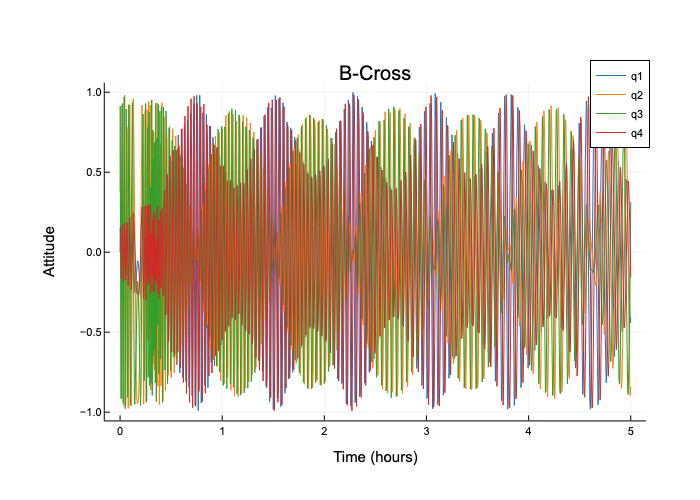

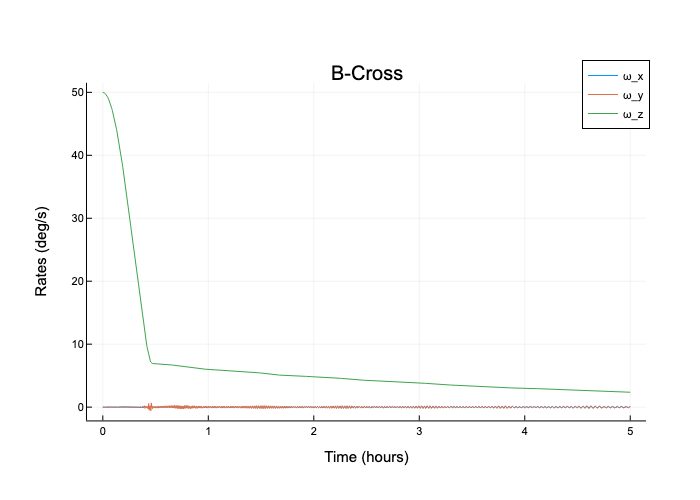

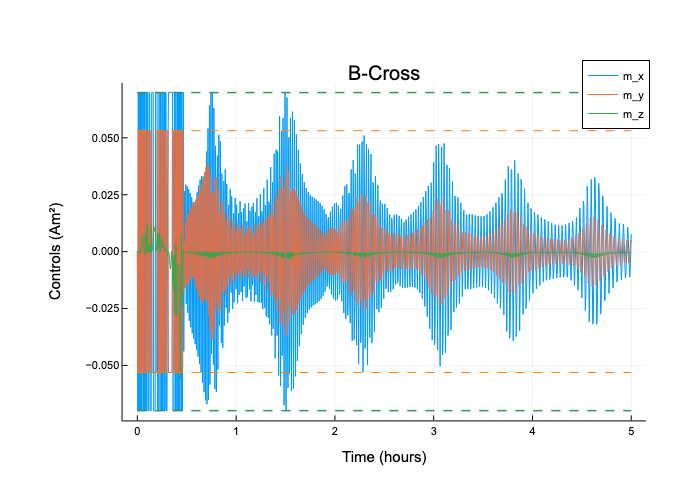

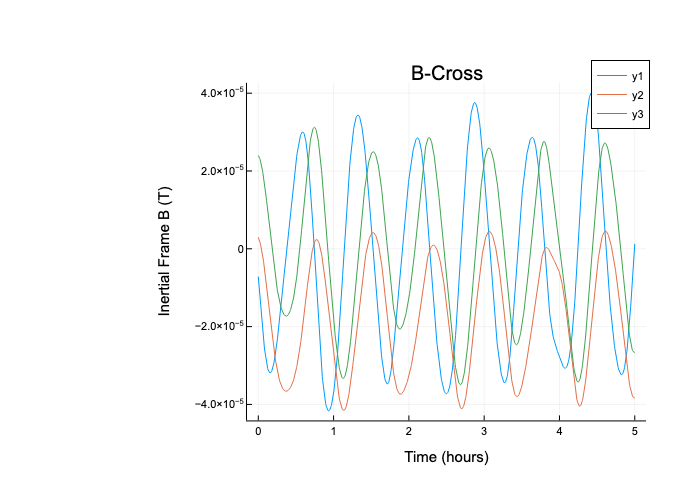

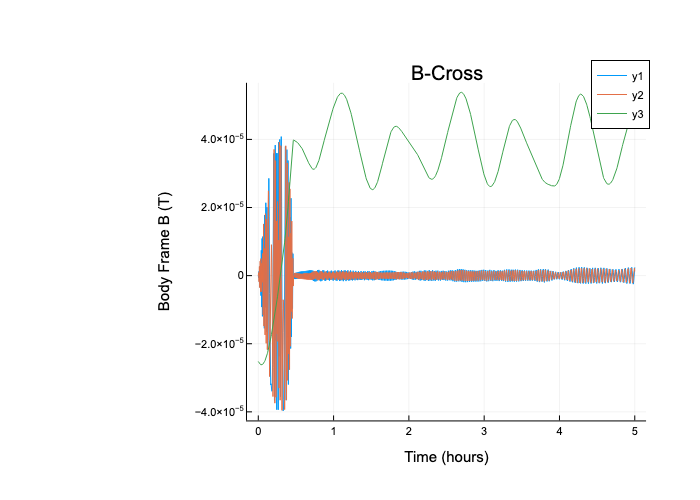

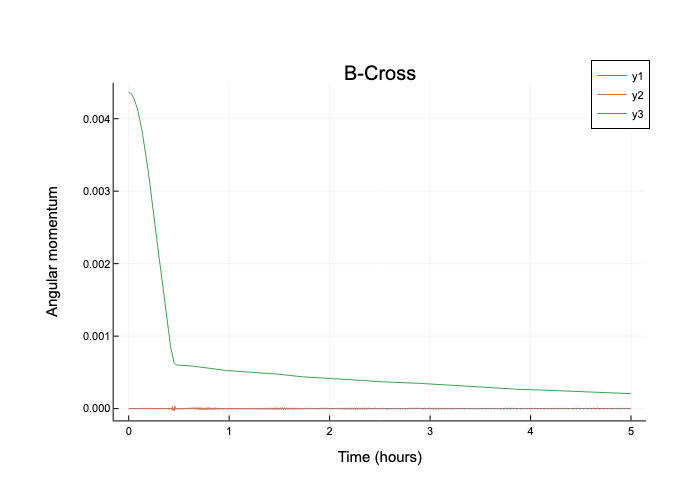

In [3]:

# 100*k_bcross causes it to track B
k_bcross = 100*bcross_gain(x_osc_0, params)
xhist_bcross, uhist_bcross, thist_bcross = simulate_satellite_orbit_attitude_rk4(x0, params, tspan; integrator_dt=0.1, controller=(x, t, m) -> bcross_control(x, t, m; k=k_bcross, saturate=true), controller_dt=0.0)
# plot_position(thist_bcross, xhist_bcross; title="B-Cross")
# plot_velocity(thist_bcross, xhist_bcross; title="B-Cross")
display(plot_attitude(thist_bcross, xhist_bcross; title="B-Cross"))
display(plot_rates(thist_bcross, xhist_bcross; title="B-Cross"))
display(plot_controls(thist_bcross, uhist_bcross, params; title="B-Cross"))
display(plot_B_inertial(thist_bcross, xhist_bcross, params; title="B-Cross"))
display(plot_B_body(thist_bcross, xhist_bcross, params; title="B-Cross"))
display(plot_angular_momentum(thist_bcross, xhist_bcross, params; title="B-Cross"))


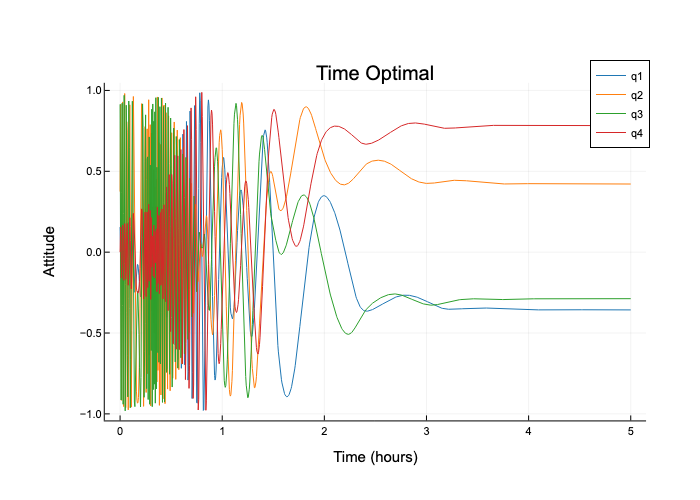

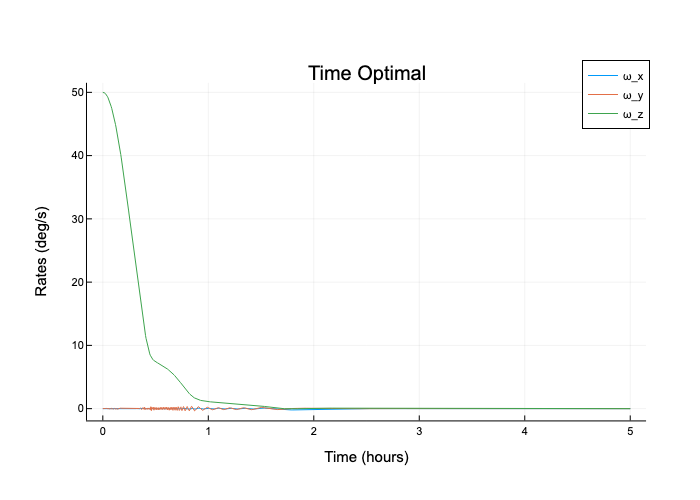

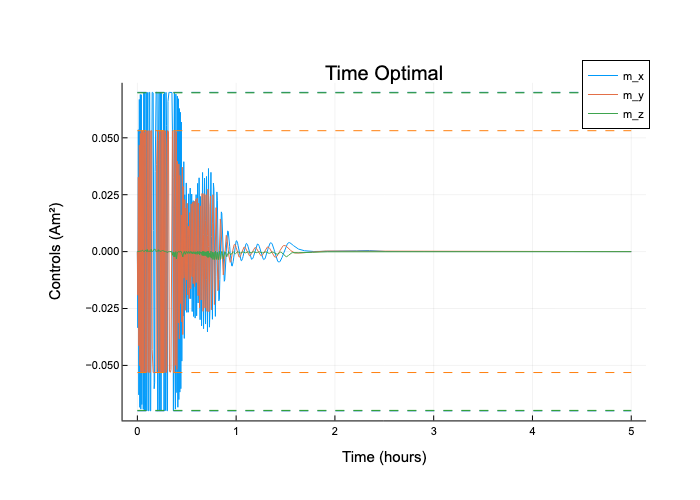

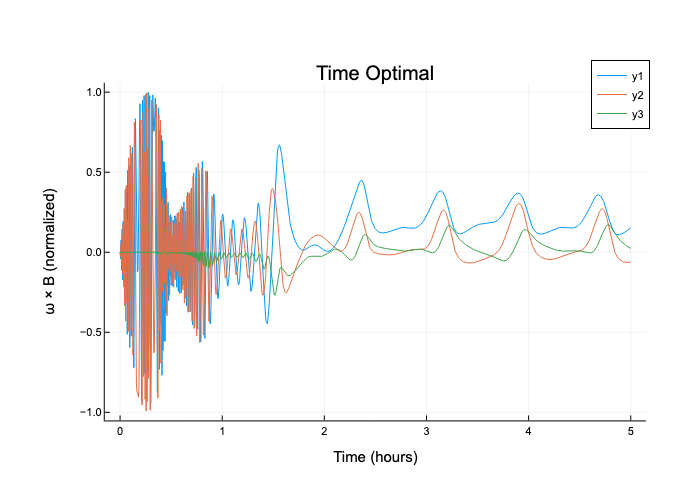

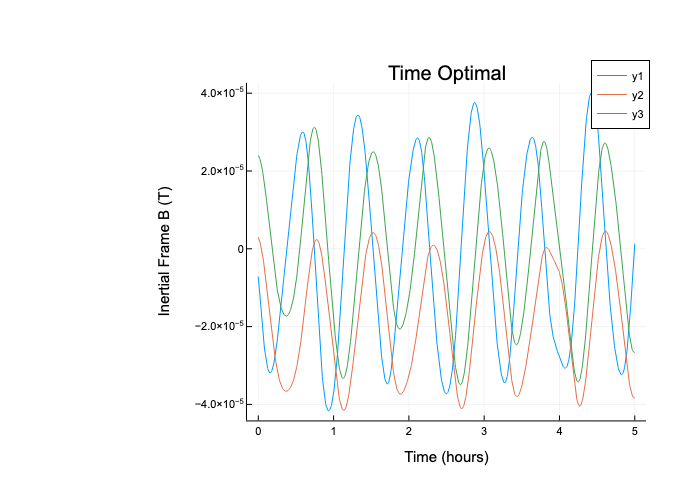

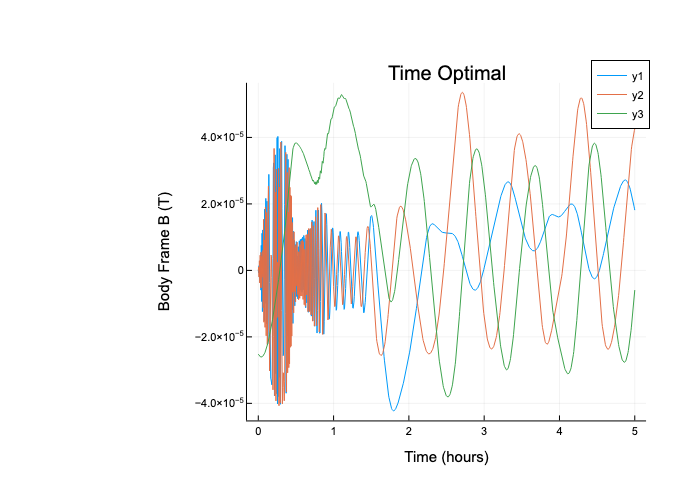

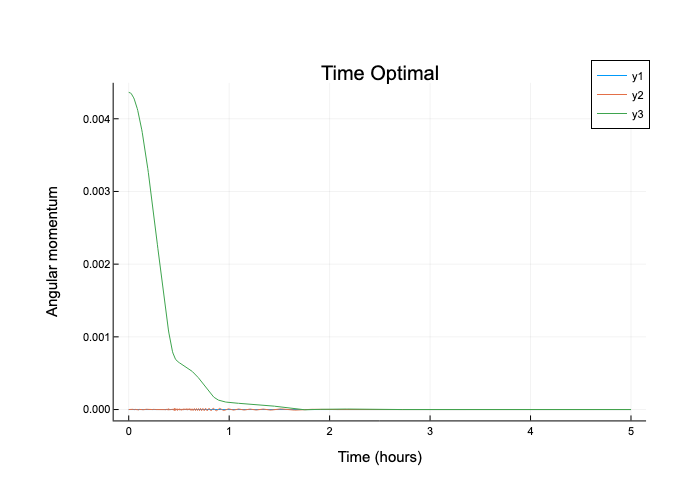

In [4]:

# gain of 1.5e1 is very good, gain of 1.5e3 causes controller to track B
xhist_bopt, uhist_bopt, thist_bopt = simulate_satellite_orbit_attitude_rk4(x0, params, tspan; integrator_dt=0.1, controller=(x, t, m) -> boptimal_control(x, t, m; k=1.5e1, saturate=true), controller_dt=0.0)

# plot_position(thist_bopt, xhist_bopt; title="Time Optimal")
# plot_velocity(thist_bopt, xhist_bopt; title="Time Optimal")
display(plot_attitude(thist_bopt, xhist_bopt; title="Time Optimal"))
display(plot_rates(thist_bopt, xhist_bopt; title="Time Optimal"))
display(plot_controls(thist_bopt, uhist_bopt, params; title="Time Optimal"))
display(plot_omega_cross_B(thist_bopt, xhist_bopt, params; title="Time Optimal"))
display(plot_B_inertial(thist_bopt, xhist_bopt, params; title="Time Optimal"))
display(plot_B_body(thist_bopt, xhist_bopt, params; title="Time Optimal"))
display(plot_angular_momentum(thist_bopt, xhist_bopt, params; title="Time Optimal"))


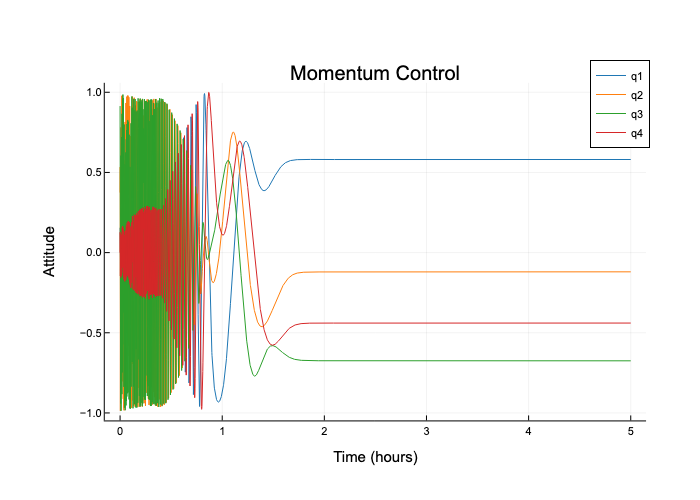

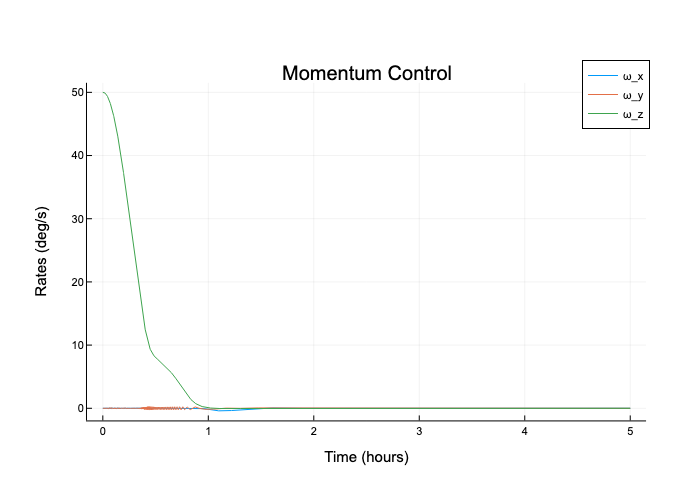

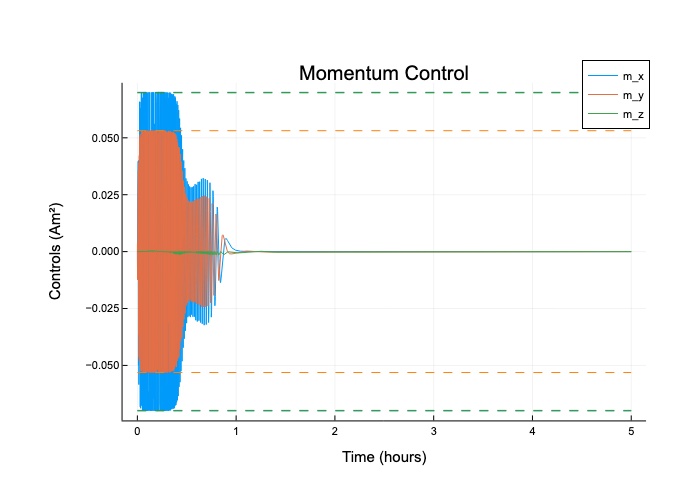

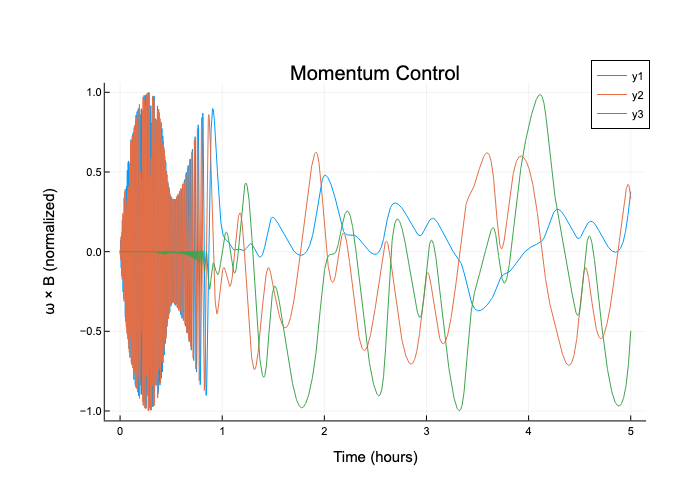

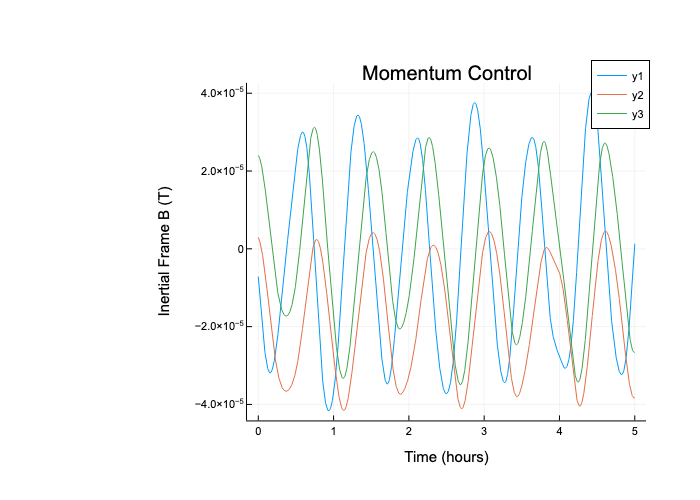

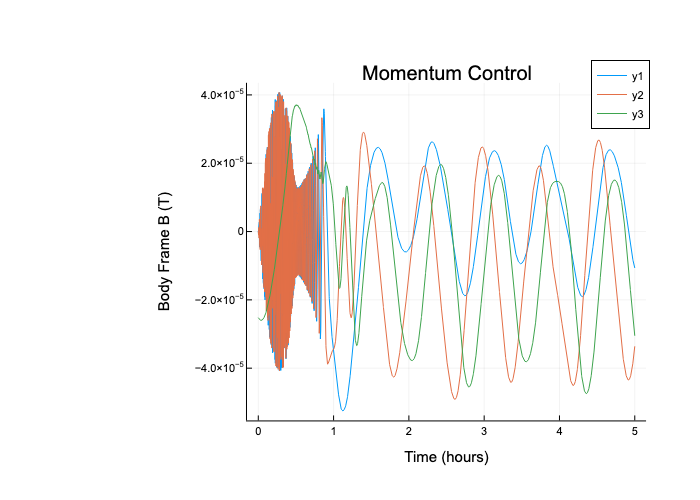

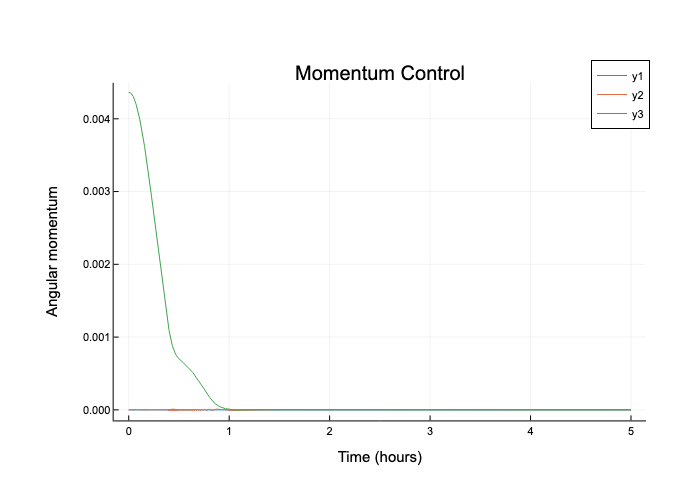

In [5]:

# gain of 2e3 is very good, gain of 2e5 causes controller to track B
xhist_momentum, uhist_momentum, thist_momentum = simulate_satellite_orbit_attitude_rk4(x0, params, tspan; integrator_dt=0.1, controller=(x, t, m) -> bmomentum_control(x, t, m; k=2e3, saturate=true), controller_dt=0.0)

# plot_position(thist_momentum, xhist_momentum; title="Momentum")
# plot_velocity(thist_momentum, xhist_momentum; title="Momentum")
display(plot_attitude(thist_momentum, xhist_momentum; title="Momentum Control", max_samples=3600))
display(plot_rates(thist_momentum, xhist_momentum; title="Momentum Control", max_samples=3600))
display(plot_controls(thist_momentum, uhist_momentum, params; title="Momentum Control", max_samples=3600))
display(plot_omega_cross_B(thist_momentum, xhist_momentum, params; title="Momentum Control", max_samples=3600))
display(plot_B_inertial(thist_momentum, xhist_momentum, params; title="Momentum Control", max_samples=3600))
display(plot_B_body(thist_momentum, xhist_momentum, params; title="Momentum Control", max_samples=3600))
display(plot_angular_momentum(thist_momentum, xhist_momentum, params; title="Momentum Control", max_samples=3600))


┌ Warning: Clamped 18000.100000000002 to 18000.0
└ @ Main /Users/jbwillis/research/non-monotonic-detumbling/src/detumble_controller.jl:148


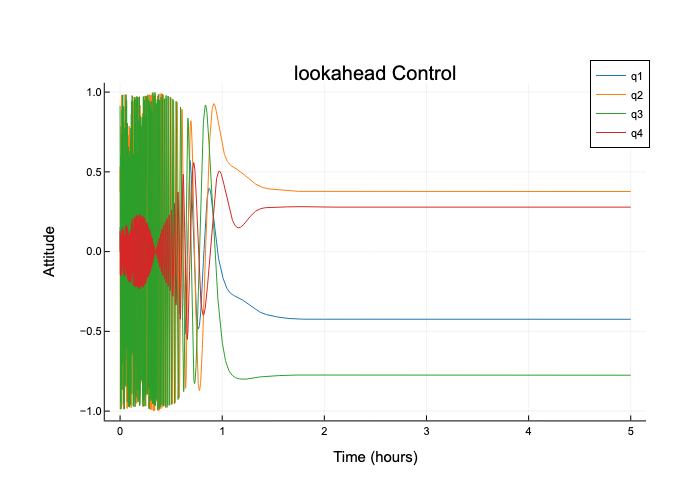

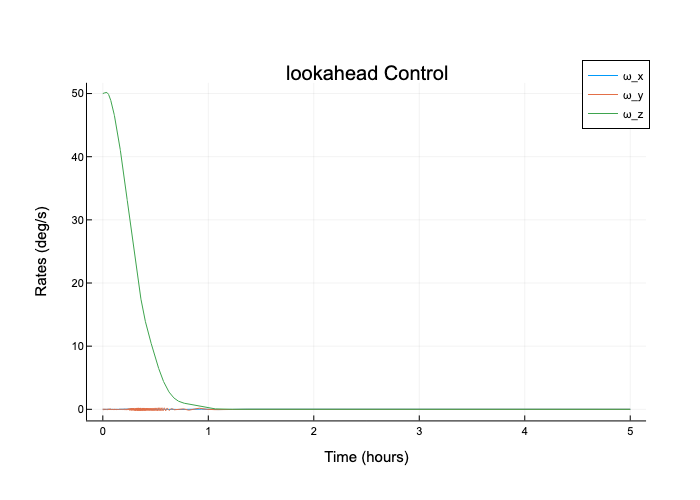

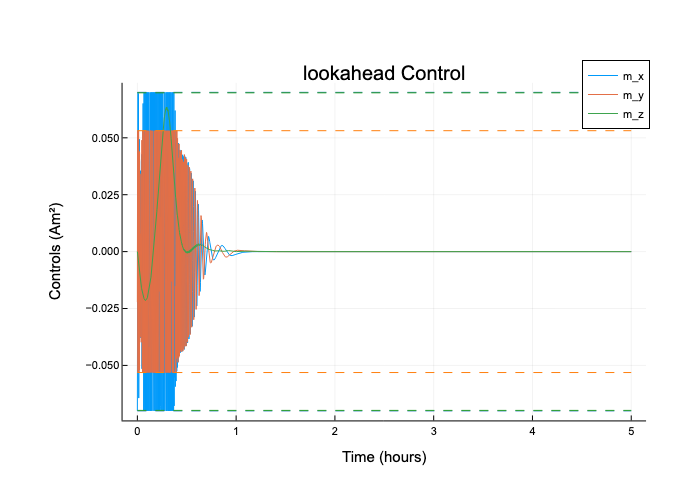

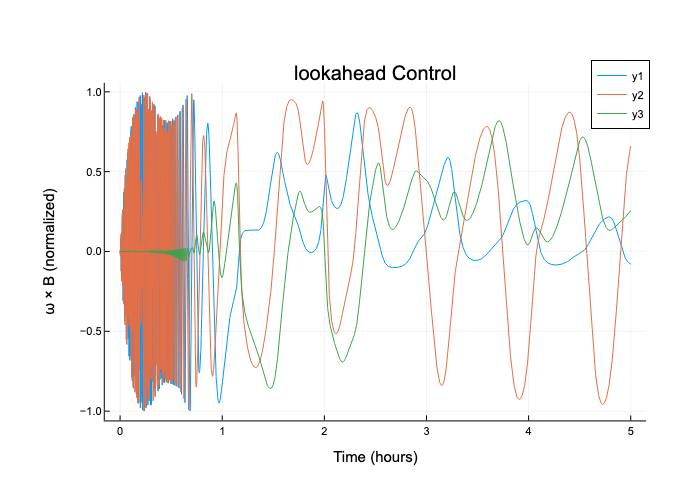

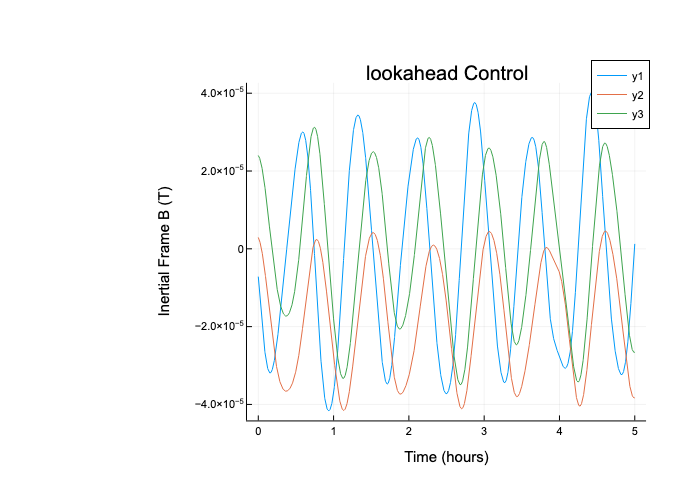

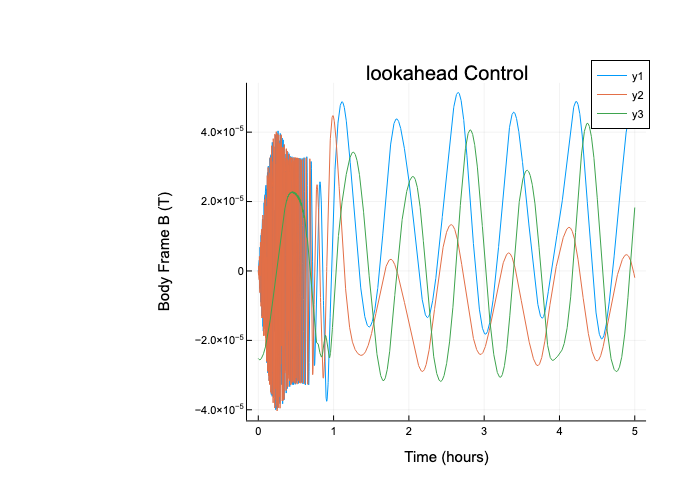

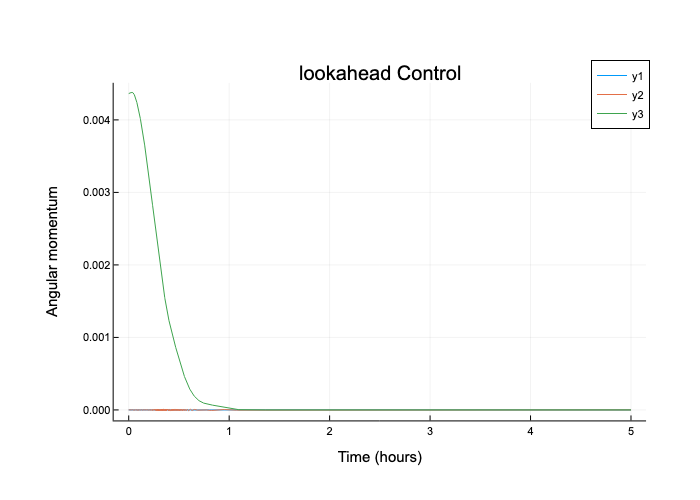

In [6]:
dt_orbit = 10.0
Nt_orbit = Int(ceil(tspan[2] / dt_orbit))
lookahead_controller = setup_blookahead_control(x0, params, dt_orbit, Nt_orbit)
xhist_lookahead, uhist_lookahead, thist_lookahead = simulate_satellite_orbit_attitude_rk4(x0, params, tspan; integrator_dt=0.1, controller=(x, t, m) -> lookahead_controller(x, t, m; k=1e2, saturate=true, α=100), controller_dt=0.0)

# plot_position(thist_lookahead, xhist_lookahead; title="lookahead")
# plot_velocity(thist_lookahead, xhist_lookahead; title="lookahead")
display(plot_attitude(thist_lookahead, xhist_lookahead; title="lookahead Control", max_samples=3600))
display(plot_rates(thist_lookahead, xhist_lookahead; title="lookahead Control", max_samples=3600))
display(plot_controls(thist_lookahead, uhist_lookahead, params; title="lookahead Control", max_samples=3600))
display(plot_omega_cross_B(thist_lookahead, xhist_lookahead, params; title="lookahead Control", max_samples=3600))
display(plot_B_inertial(thist_lookahead, xhist_lookahead, params; title="lookahead Control", max_samples=3600))
display(plot_B_body(thist_lookahead, xhist_lookahead, params; title="lookahead Control", max_samples=3600))
display(plot_angular_momentum(thist_lookahead, xhist_lookahead, params; title="lookahead Control", max_samples=3600))

In [7]:
xhist_derivative, uhist_derivative, thist_derivative = simulate_satellite_orbit_attitude_rk4(x0, params, tspan; integrator_dt=0.1, controller=(x, t, m) -> bderivative_control(x, t, m; k=3e2, saturate=true, α=100), controller_dt=0.0)

# plot_position(thist_derivative, xhist_derivative; title="derivative")
# plot_velocity(thist_derivative, xhist_derivative; title="derivative")
display(plot_attitude(thist_derivative, xhist_derivative; title="Lookahead Derivative Control", max_samples=3600))
display(plot_rates(thist_derivative, xhist_derivative; title="Lookahead Derivative Control", max_samples=3600))
display(plot_controls(thist_derivative, uhist_derivative, params; title="Lookahead Derivative Control", max_samples=3600))
display(plot_omega_cross_B(thist_derivative, xhist_derivative, params; title="Lookahead Derivative Control", max_samples=3600))
display(plot_B_inertial(thist_derivative, xhist_derivative, params; title="Lookahead Derivative Control", max_samples=3600))
display(plot_B_body(thist_derivative, xhist_derivative, params; title="Lookahead Derivative Control", max_samples=3600))
display(plot_angular_momentum(thist_derivative, xhist_derivative, params; title="Lookahead Derivative Control", max_samples=3600))

UndefVarError: UndefVarError: α not defined

Derivative control and Lookahead control use the same basic control law, but derivative control has the substitution $B_2 = B1 + \Delta t \dot{B}_1$